In [1]:
# !pip install -q opendatasets 
# import opendatasets as od

!pip -q install tensorflow_hub
import tensorflow_hub as hub

import os
import datetime
import time

from matplotlib import pyplot as plt
from matplotlib import gridspec
import numpy as np

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Model, Sequential
from tensorflow.keras.layers import Conv2D, BatchNormalization, LeakyReLU, Conv2DTranspose, Dropout, ReLU, Input, Concatenate, concatenate
from tqdm import tqdm

gpus = tf.config.list_physical_devices('GPU')
print("GPU available: ", gpus)

GPU available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        print(e)

1 Physical GPUs, 1 Logical GPUs


In [3]:
# od.download("https://www.kaggle.com/ktaebum/anime-sketch-colorization-pair")
# !rm -r anime-sketch-colorization-pair/data/data
# !rm -r anime-sketch-colorization-pair/data/colorgram

In [4]:
def read_png(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_png(img, channels=3)
    return img

In [5]:
def split_image(image):
    w = tf.shape(image)[1]
    w = w // 2
    sketch_image = image[:, :w, :]
    colored_image = image[:, w:, :]
    sketch_image = tf.image.resize(sketch_image, (256, 256))
    colored_image = tf.image.resize(colored_image, (256, 256))
    return sketch_image, colored_image

In [6]:
def flip_image(image):
    return tf.image.flip_left_right(image)

def random_jitter(sketch_image, colored_image):

    if tf.random.uniform(()) > 0.5:
        sketch_image = flip_image(sketch_image)
        colored_image = flip_image(colored_image)

    return sketch_image, colored_image

In [7]:
def normalize_symmetric(sketch_image, colored_image):
    sketch_image = tf.cast(sketch_image, tf.float32)/127.5 - 1
    colored_image = tf.cast(colored_image, tf.float32)/127.5 - 1
    return sketch_image, colored_image

def normalize_zero_to_one(sketch_image, colored_image):
    sketch_image = tf.cast(sketch_image, tf.float32)/255
    colored_image = tf.cast(colored_image, tf.float32)/255
    return sketch_image, colored_image

In [8]:
def image_loader(train=False, normalization_fn=normalize_zero_to_one):
    def load_image(image_path):
        image = read_png(image_path)
        sketch_image, colored_image = split_image(image)
        sketch_image, colored_image = normalization_fn(sketch_image, colored_image)
        
        if train:
            sketch_image, colored_image = random_jitter(sketch_image, colored_image)

        return colored_image, sketch_image

    return load_image

In [9]:
def show_n(images, titles=('',)):
    n = len(images)
    image_sizes = [image.shape[1] for image in images]
    w = (image_sizes[0] * 6) // 320
    plt.figure(figsize=(w * n, w))
    gs = gridspec.GridSpec(1, n, width_ratios=image_sizes)
    for i in range(n):
        plt.subplot(gs[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(images[i]), aspect='equal')
        plt.axis('off')
        plt.title(titles[i] if len(titles) > i else '')
    plt.show()

In [10]:
train_path = './anime-sketch-colorization-pair/data/train/'
train_images_path = [os.path.join(train_path, image_name) for image_name in os.listdir(train_path)]
print(f'Training samples = {len(train_images_path)}')

test_path = './anime-sketch-colorization-pair/data/val/'
test_images_path = [os.path.join(test_path, image_name) for image_name in os.listdir(test_path)]
print(f'Test samples = {len(test_images_path)}')

Training samples = 14224
Test samples = 3545


In [11]:
BATCH_SIZE = 32
BUFFER_SIZE = 400

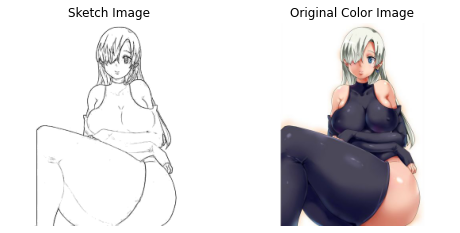

In [12]:
test_dataset = tf.data.Dataset.from_tensor_slices(test_images_path)
test_dataset = test_dataset.map(image_loader(train=False, normalization_fn=normalize_symmetric))
test_dataset = test_dataset.batch(BATCH_SIZE)

for sketches, colors in test_dataset.take(1):
    show_n([sketches[0], colors[0]], titles=['Sketch Image', 'Original Color Image'])

In [13]:
hub_handle = 'https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2'
hub_module = hub.load(hub_handle)

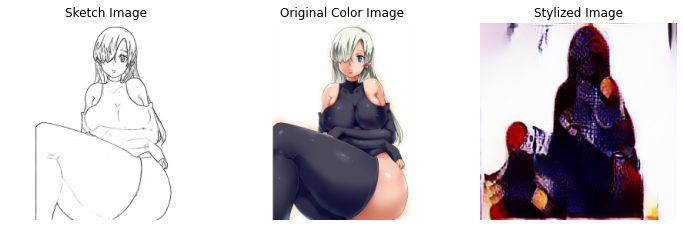

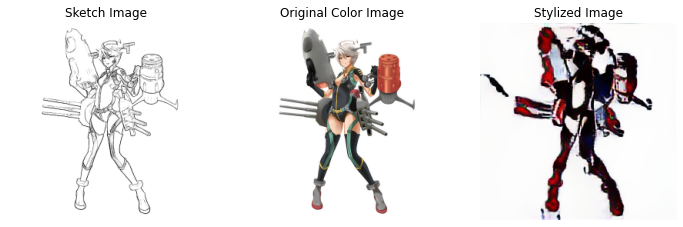

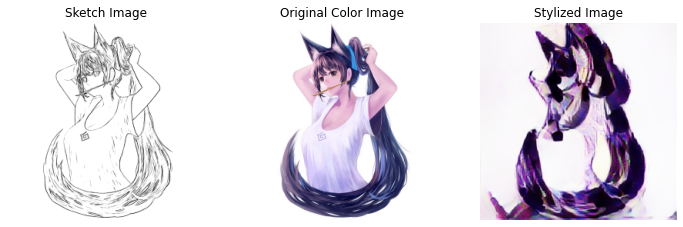

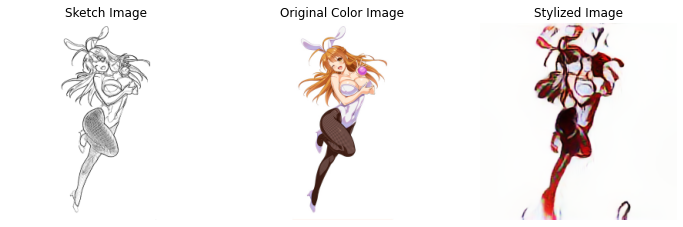

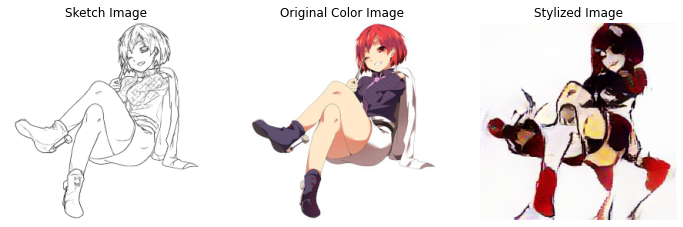

...

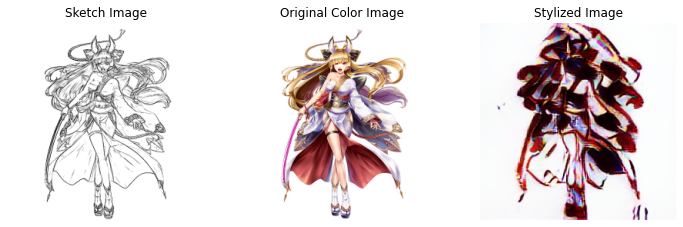

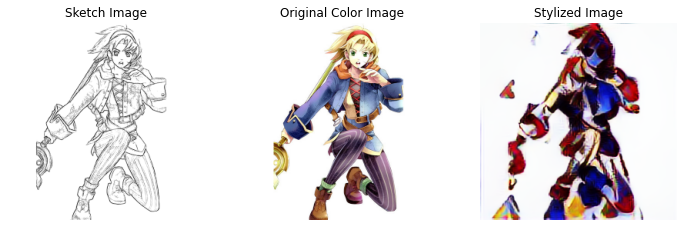

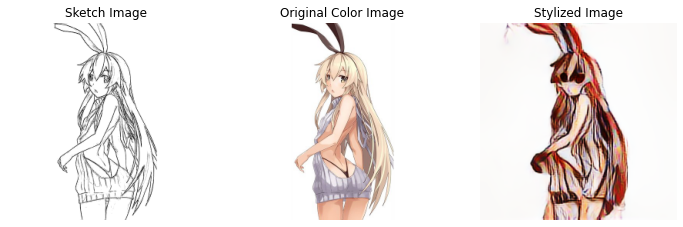

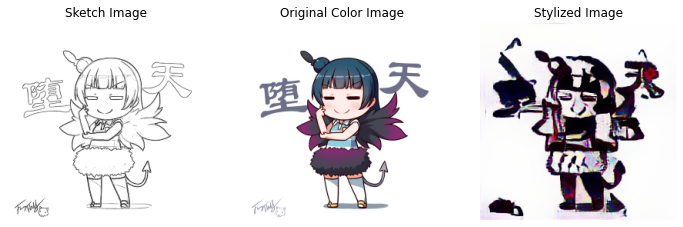

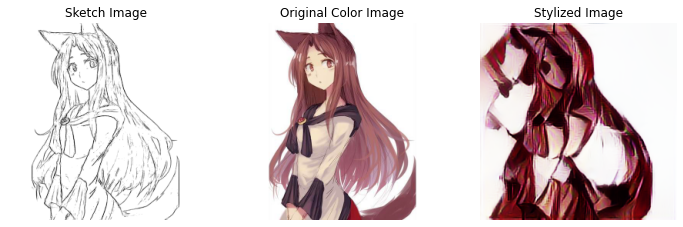

In [14]:
for sketches, colors in test_dataset.take(4):
    for i in range(len(sketches)):
        outputs = hub_module(tf.constant(sketches[i:i+1]), tf.constant(colors[i:i+1]))
        stylized_images = outputs[0]
        show_n([sketches[i], colors[i], stylized_images[0]], titles=['Sketch Image', 'Original Color Image', 'Stylized Image'])
    

In [15]:
mae = 0
count = 0
for i, (sketches, colors) in tqdm(test_dataset.enumerate()):
    count += 1
    m = 0
    for i in range(len(sketches)):
        outputs = hub_module(sketches[i:i+1], colors[i:i+1])
        generated = outputs[0]
        loss = tf.reduce_mean(tf.abs(colors[i:i+1] - generated))
        m += loss
    mae += m / len(sketches)
print(f'avg mae = {mae / count}')

100%|██████████| 111/111 [01:47<00:00,  1.03it/s]

avg mae = 0.2236475795507431


avg mae = 0.2236475795507431

In [23]:
ssim = 0
count = 0
for i, (sketches, colors) in tqdm(test_dataset.enumerate()):
    count += 1
    s = 0
    for i in range(len(sketches)):
        outputs = hub_module(sketches[i:i+1], colors[i:i+1])
        generated = outputs[0]
        loss = tf.image.ssim(generated[0], colors[i], 255)
        s += loss
    ssim += s / len(sketches)
print(f'avg ssim = {ssim / count}')

100%|██████████| 111/111 [04:21<00:00,  2.36s/it]

avg ssim = 0.48149818181991577


avg ssim = 0.48149818181991577

In [29]:
from scipy import linalg

def calculate_fid(real, generated):
    fid = 0
    for i in range(3):
        # calculate mean and covariance statistics
        mu1, sigma1 = real.mean(axis=0), np.cov(real[:,:,i], rowvar=False)
        mu2, sigma2 = generated.mean(axis=0), np.cov(generated[:,:,i], rowvar=False)

        # calculate sum squared difference between means
        ssdiff = np.sum((mu1 - mu2)**2.0)

        # calculate sqrt of product between cov
        covmean = linalg.sqrtm(sigma1.dot(sigma2))

        # check and correct imaginary numbers from sqrt
        if np.iscomplexobj(covmean):
            covmean = covmean.real

        # calculate score
        fid += ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid/3

In [ ]:
fid = 0
count = 0
for i, (sketches, colors) in tqdm(test_dataset.enumerate()):
    count += 1
    m = 0
    for i in range(len(sketches)):
        outputs = hub_module(sketches[i:i+1], colors[i:i+1])
        generated = outputs[0]
        loss = calculate_fid(colors[i].numpy(), generated[0].numpy())
        m += loss
    fid += m / len(sketches)
print(f'avg fid = {fid / count}')

100%|██████████| 111/111 [16:25<00:00,  8.51s/it]